In [1]:
import os
import glob as glob
import matplotlib.pyplot as plt
import cv2
import requests
import random
import numpy as np

In [2]:
TRAIN = True
# Number of epochs to train for.
EPOCHS = 25

In [3]:
if not os.path.exists('train'):
    !curl -L "https://app.roboflow.com/ds/DRSFEqJABH?key=Wdk05NnpA9" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

    dirs = ['train', 'valid', 'test']

    for i, dir_name in enumerate(dirs):
        all_image_names = sorted(os.listdir(f"{dir_name}/images/"))
        for j, image_name in enumerate(all_image_names):
            if (j % 2) == 0:
                file_name = image_name.split('.jpg')[0]
                os.remove(f"{dir_name}/images/{image_name}")
                os.remove(f"{dir_name}/labels/{file_name}.txt")

Streaming output truncated to the last 5000 lines.
 extracting: train/images/BikesHelmets621_png_jpg.rf.42d1f82e230933a8ab78383b352f414f.jpg  
 extracting: train/images/BikesHelmets621_png_jpg.rf.59c30ebdf37da7325543daa2592bb017.jpg  
 extracting: train/images/BikesHelmets621_png_jpg.rf.66351020962e80ad5666d995ca48a22c.jpg  
 extracting: train/images/BikesHelmets621_png_jpg.rf.83ba52473d35f552ae85a818d009aa20.jpg  
 extracting: train/images/BikesHelmets621_png_jpg.rf.897a89187f3cc3b33a01361b53b641a4.jpg  
 extracting: train/images/BikesHelmets621_png_jpg.rf.a20c934e2be04978833c8467ed0a737a.jpg  
 extracting: train/images/BikesHelmets621_png_jpg.rf.cbbcd13bdba966ccb53d27af8b2496eb.jpg  
 extracting: train/images/BikesHelmets629_png_jpg.rf.0399a8f056fd6d20825692b8ac119454.jpg  
 extracting: train/images/BikesHelmets629_png_jpg.rf.2b82c3cf8fd6eaeb894654609eb6c712.jpg  
 extracting: train/images/BikesHelmets629_png_jpg.rf.448bed9af8b102bbc66761f97f66975d.jpg  
 extracting: train/images/Bik

In [4]:
def download_file(url, save_name):
    url = url
    if not os.path.exists(save_name):
        file = requests.get(url)
        open(save_name, 'wb').write(file.content)
    else:
        print('File already present, skipping download...')

In [5]:
class_names = ['Bike without Helmet','BikeWith Helmet','With Helmet','Without Helmet']
colors = np.random.uniform(0, 255, size=(len(class_names), 3))

In [6]:
def yolo2bbox(bboxes):
    xmin, ymin = bboxes[0]-bboxes[2]/2, bboxes[1]-bboxes[3]/2
    xmax, ymax = bboxes[0]+bboxes[2]/2, bboxes[1]+bboxes[3]/2
    return xmin, ymin, xmax, ymax

In [7]:
def plot_box(image, bboxes, labels):
    # Need the image height and width to denormalize
    # the bounding box coordinates
    h, w, _ = image.shape
    for box_num, box in enumerate(bboxes):
        x1, y1, x2, y2 = yolo2bbox(box)
        # denormalize the coordinates
        xmin = int(x1*w)
        ymin = int(y1*h)
        xmax = int(x2*w)
        ymax = int(y2*h)
        width = xmax - xmin
        height = ymax - ymin

        class_name = class_names[int(labels[box_num])]

        cv2.rectangle(
            image,
            (xmin, ymin), (xmax, ymax),
            color=colors[class_names.index(class_name)],
            thickness=2
        )

        font_scale = min(1,max(3,int(w/500)))
        font_thickness = min(2, max(10,int(w/50)))

        p1, p2 = (int(xmin), int(ymin)), (int(xmax), int(ymax))
        # Text width and height
        tw, th = cv2.getTextSize(
            class_name,
            0, fontScale=font_scale, thickness=font_thickness
        )[0]
        p2 = p1[0] + tw, p1[1] + -th - 10
        cv2.rectangle(
            image,
            p1, p2,
            color=colors[class_names.index(class_name)],
            thickness=-1,
        )
        cv2.putText(
            image,
            class_name,
            (xmin+1, ymin-10),
            cv2.FONT_HERSHEY_SIMPLEX,
            font_scale,
            (255, 255, 255),
            font_thickness
        )
    return image

In [8]:
# Function to plot images with the bounding boxes.
def plot(image_paths, label_paths, num_samples):
    all_training_images = glob.glob(image_paths)
    all_training_labels = glob.glob(label_paths)
    all_training_images.sort()
    all_training_labels.sort()

    num_images = len(all_training_images)

    plt.figure(figsize=(15, 12))
    for i in range(num_samples):
        j = random.randint(0,num_images-1)
        image = cv2.imread(all_training_images[j])
        with open(all_training_labels[j], 'r') as f:
            bboxes = []
            labels = []
            label_lines = f.readlines()
            for label_line in label_lines:
                label = label_line[0]
                bbox_string = label_line[2:]
                x_c, y_c, w, h = bbox_string.split(' ')
                x_c = float(x_c)
                y_c = float(y_c)
                w = float(w)
                h = float(h)
                bboxes.append([x_c, y_c, w, h])
                labels.append(label)
        result_image = plot_box(image, bboxes, labels)
        plt.subplot(2, 2, i+1)
        plt.imshow(result_image[:, :, ::-1])
        plt.axis('off')
    plt.subplots_adjust(wspace=0)
    plt.tight_layout()
    plt.show()

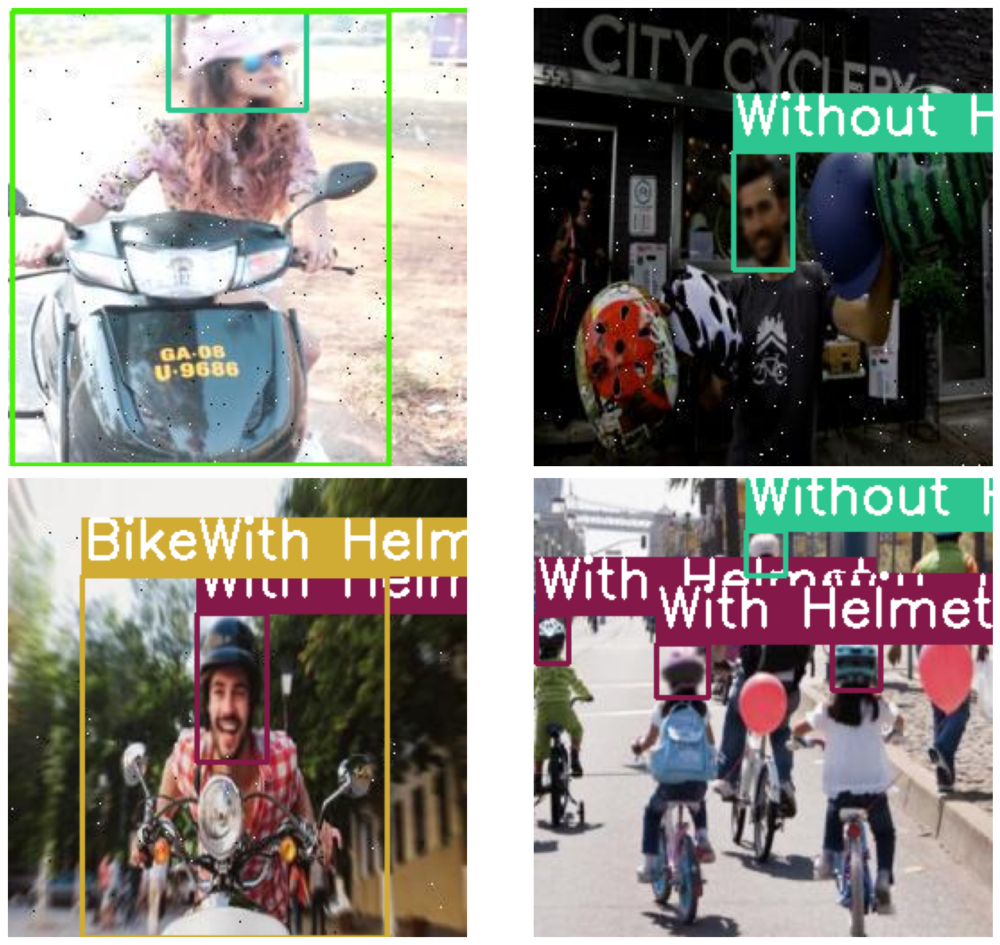

In [9]:
# Visualize a few training images.
plot(
    image_paths='train/images/*',
    label_paths='train/labels/*',
    num_samples=4,
)

In [10]:
def set_res_dir():
    # Directory to store results
    res_dir_count = len(glob.glob('runs/train/*'))
    print(f"Current number of result directories: {res_dir_count}")
    if TRAIN:
        RES_DIR = f"results_{res_dir_count+1}"
        print(RES_DIR)
    else:
        RES_DIR = f"results_{res_dir_count}"
    return RES_DIR

In [11]:
def monitor_tensorboard():
    %load_ext tensorboard
    %tensorboard --logdir runs/train

In [12]:
if not os.path.exists('yolov5'):
    !git clone https://github.com/ultralytics/yolov5.git

Cloning into 'yolov5'...
remote: Enumerating objects: 17045, done.
remote: Counting objects: 100% (23/23), done.
remote: Compressing objects: 100% (15/15), done.
remote: Total 17045 (delta 10), reused 18 (delta 8), pack-reused 17022 (from 1)
Receiving objects: 100% (17045/17045), 15.67 MiB | 16.02 MiB/s, done.
Resolving deltas: 100% (11704/11704), done.


In [13]:
%cd yolov5/
!pwd

/content/yolov5
/content/yolov5


In [14]:
!pip install -r requirements.txt

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 887.0/887.0 kB 54.4 MB/s eta 0:00:00


In [15]:
monitor_tensorboard()

<IPython.core.display.Javascript object>

In [16]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data ../data.yaml --weights yolov5s.pt \
    --img 640 --epochs {EPOCHS} --batch-size 16 --name {RES_DIR}\
    --project /content/Model_Weights

Streaming output truncated to the last 5000 lines.
val: New cache created: /content/valid/labels.cache

AutoAnchor: 4.83 anchors/target, 1.000 Best Possible Recall (BPR). Current anchors are a good fit to dataset ✅
Plotting labels to /content/Model_Weights/results_1/labels.jpg... 
/content/yolov5/train.py:355: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = torch.cuda.amp.GradScaler(enabled=amp)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to /content/Model_Weights/results_1
Starting training for 25 epochs...

      Epoch    GPU_mem   box_loss   obj_loss   cls_loss  Instances       Size
  0% 0/97 [00:00<?, ?it/s]/content/yolov5/train.py:412: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(amp):
       0/24      3.51G     0.1136    0.05322    0.04557        116     

In [33]:
# Function to show validation predictions saved during training.
def show_valid_results(RES_DIR):
    !ls runs/train/{RES_DIR}
    EXP_PATH = f"{RES_DIR}"
    validation_pred_images = glob.glob(f"{EXP_PATH}/*_pred.jpg")
    print(validation_pred_images)
    for pred_image in validation_pred_images:
        image = cv2.imread(pred_image)
        plt.figure(figsize=(19, 16))
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
        plt.show()

In [55]:
# Helper function for inference on images.
def inference(RES_DIR, data_path):
    # Directory to store inference results.
    infer_dir_count = len(glob.glob('/content/yolov5/runs/detect/*'))
    print(f"Current number of inference detection directories: {infer_dir_count}")
    INFER_DIR = f"inference_{infer_dir_count+1}"
    print(INFER_DIR)
    # Inference on images.
    !python detect.py --weights {RES_DIR}/weights/best.pt \
    --source {data_path} --name {INFER_DIR}
    return INFER_DIR

In [28]:
def visualize(INFER_DIR):
# Visualize inference images.
    INFER_PATH = f"runs/detect/{INFER_DIR}"
    infer_images = glob.glob(f"{INFER_PATH}/*.jpg")
    print(infer_images)
    for pred_image in infer_images:
        image = cv2.imread(pred_image)
        plt.figure(figsize=(19, 16))
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
        plt.show()

ls: cannot access 'runs/train//content/Model_Weights/results_1': No such file or directory
['/content/Model_Weights/results_1/val_batch0_pred.jpg', '/content/Model_Weights/results_1/val_batch1_pred.jpg', '/content/Model_Weights/results_1/val_batch2_pred.jpg']


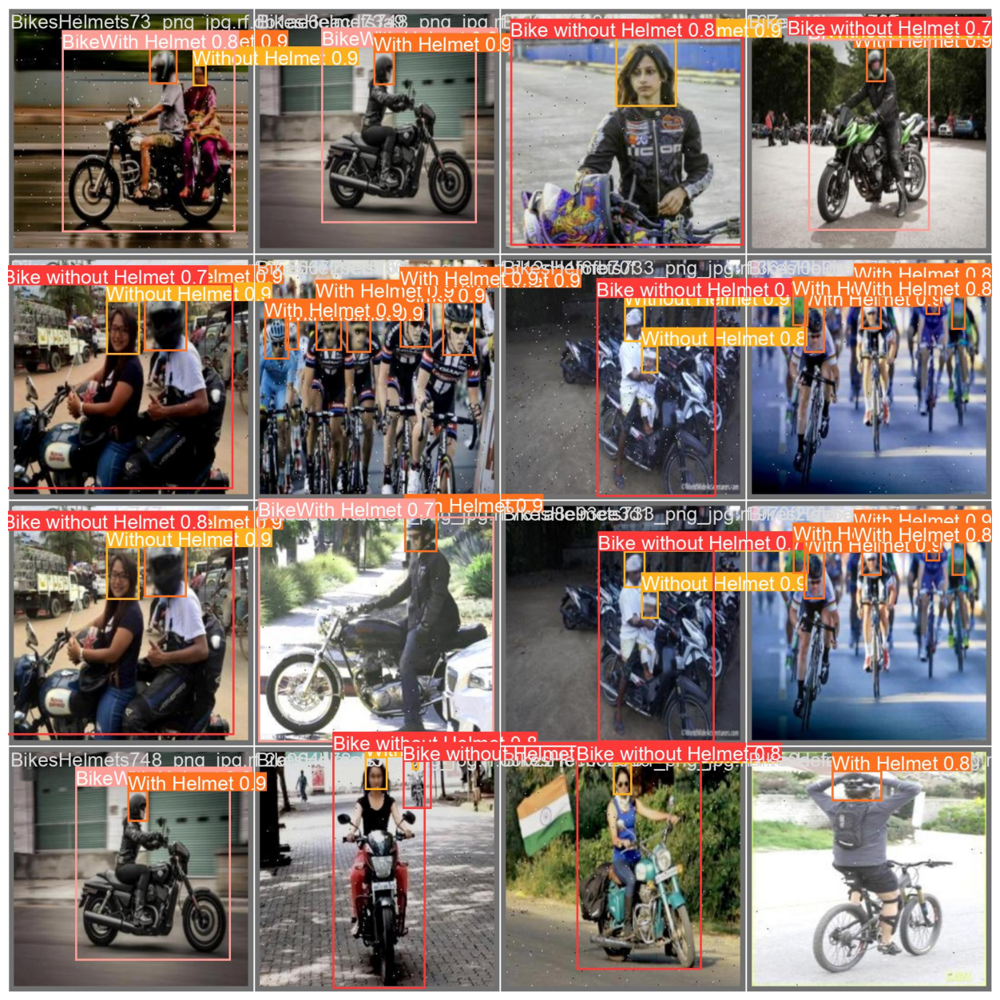

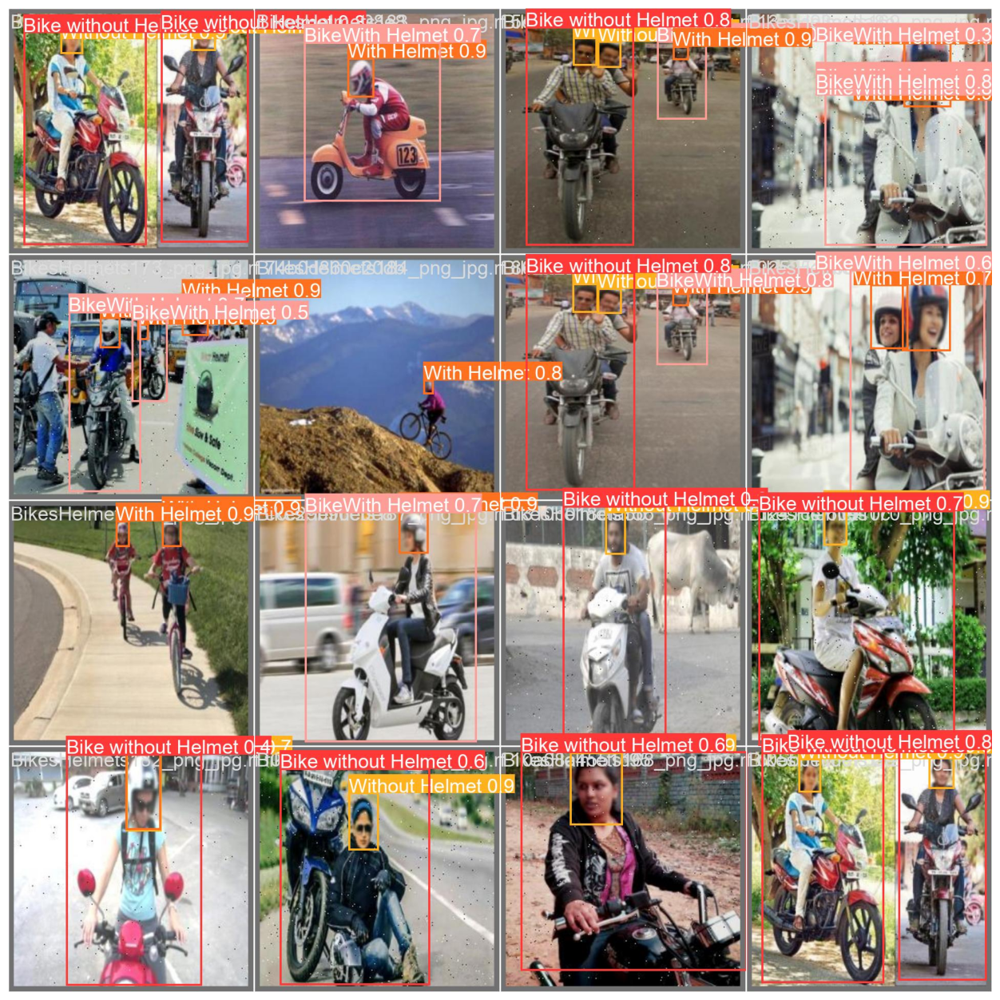

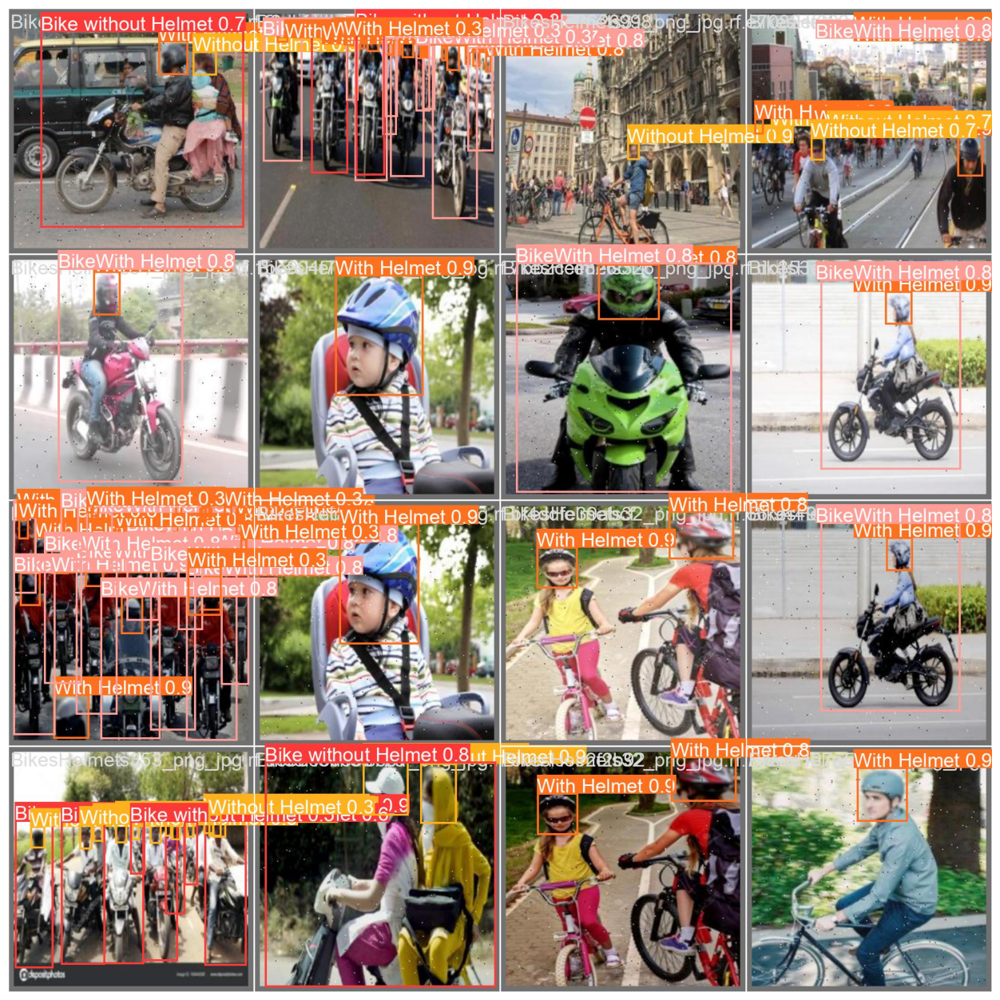

In [34]:
show_valid_results('/content/Model_Weights/results_1')

In [56]:
IMAGE_INFER_DIR = inference('/content/Model_Weights/results_1',"/content/motorcycle-tours-india.jpg")

Current number of inference detection directories: 12
inference_13
detect: weights=['/content/Model_Weights/results_1/weights/best.pt'], source=/content/motorcycle-tours-india.jpg, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_format=0, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=inference_13, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-383-g1435a8ee Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7020913 parameters, 0 gradients, 15.8 GFLOPs
image 1/1 /content/motorcycle-tours-india.jpg: 288x640 1 Bike without Helmet, 6 BikeWith Helmets, 5 With Helmets, 3 Without Helmets, 32.2ms
Speed: 0.4ms pre-process, 32.2ms inference, 544.3ms NMS per imag

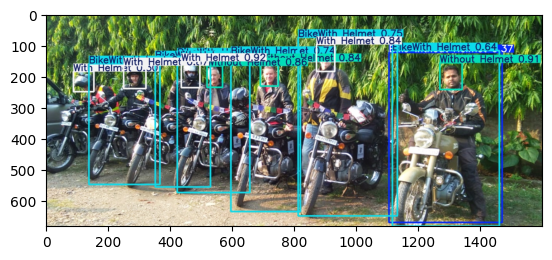

In [57]:
image=cv2.imread("/content/yolov5/runs/detect/inference_132/motorcycle-tours-india.jpg")
plt.imshow(image[:,:,::-1])